In [3]:
import boto3 # <- AWS API SDK lets you interact with s3 buckets, official AWS tool
from botocore.config import Config # <- used to authenticate
from botocore import UNSIGNED # <- some sort of enum value, we don't need creds to access this bucket
import io
from PIL import Image # Could be replaced by OpenCV or Ultralytics

import get_annotations

In [4]:
# Anonymous S3 client (public bucket; no creds needed)
s3 = boto3.client(
    "s3",
    region_name="us-east-1",
    config=Config(signature_version=UNSIGNED)
) # communicate to AWS thru this object


In [5]:
def get_image_s3(image_id: str, bucket: str = "coral-reef-training", thumbnail: bool = False) -> Image.Image:
    key = f"mermaid/{image_id}_thumbnail.png" if thumbnail else f"mermaid/{image_id}.png" # image to get
    resp = s3.get_object(Bucket=bucket, Key=key) # what is returned from s3
    return Image.open(io.BytesIO(resp["Body"].read()))

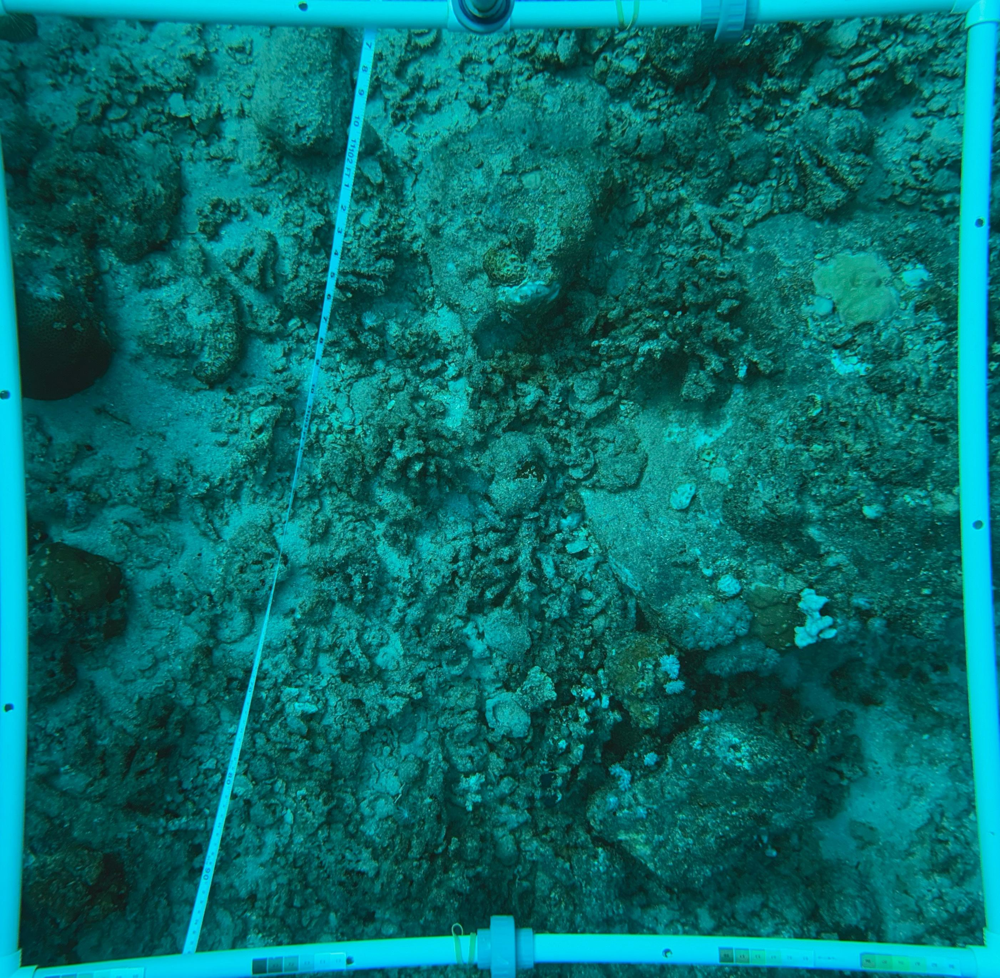

In [ ]:
df_annotations, df_images = get_annotations.get_annotations()
# Example (uses df_images/df_annotations from your first chunk)
idx = 0
image_id = df_images.loc[idx, "image_id"]
image = get_image_s3(image_id, thumbnail=False).convert("RGB")

# # Get the annotations for the associated image
# annotations = df_annotations.loc[df_annotations["image_id"] == image_id] # annotations imported from

# (Quarto) display inline
from IPython.display import display
display(image)